In [2]:
import package_root
import sdd.constrained_sdd as sdd

/tmp/ipykernel_60469/3160314975.py:27: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  polygon_colors = {t: plt.cm.get_cmap("tab20")(i) for i, t in enumerate(dataset.constraint_classes)}


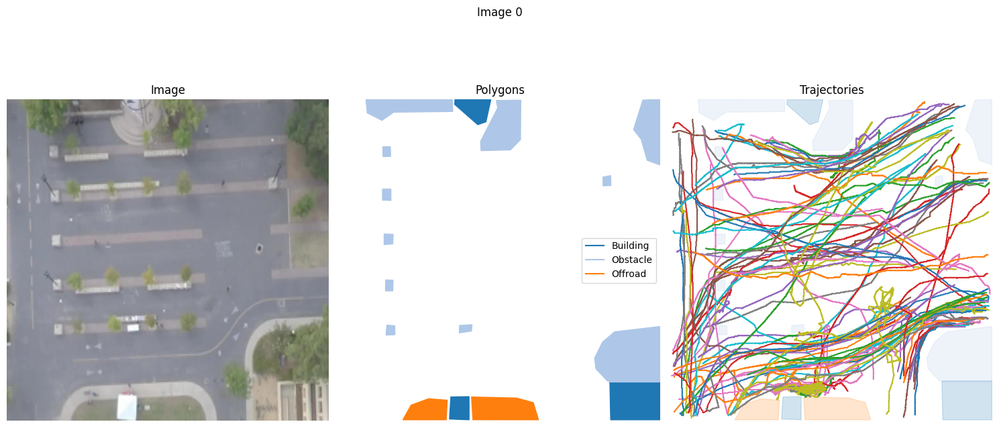

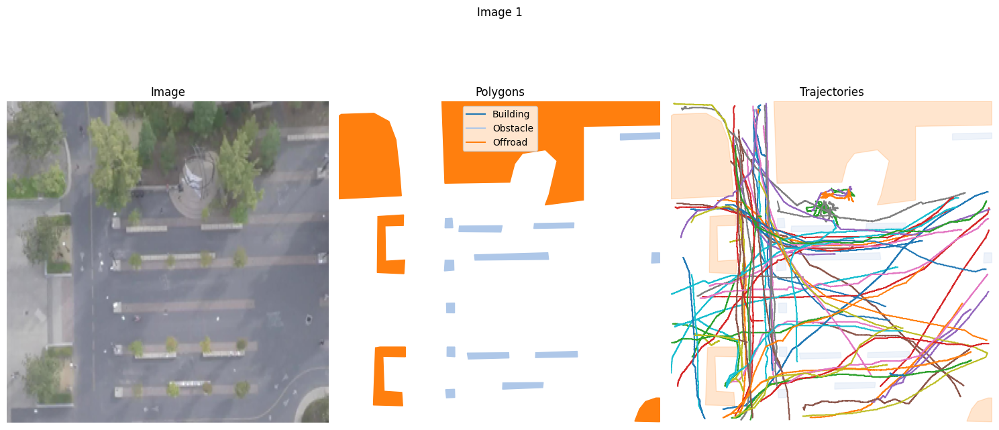

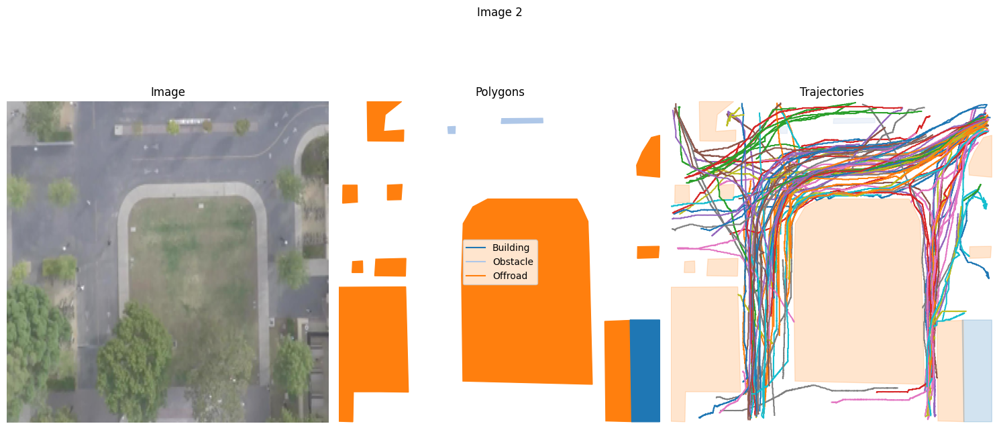

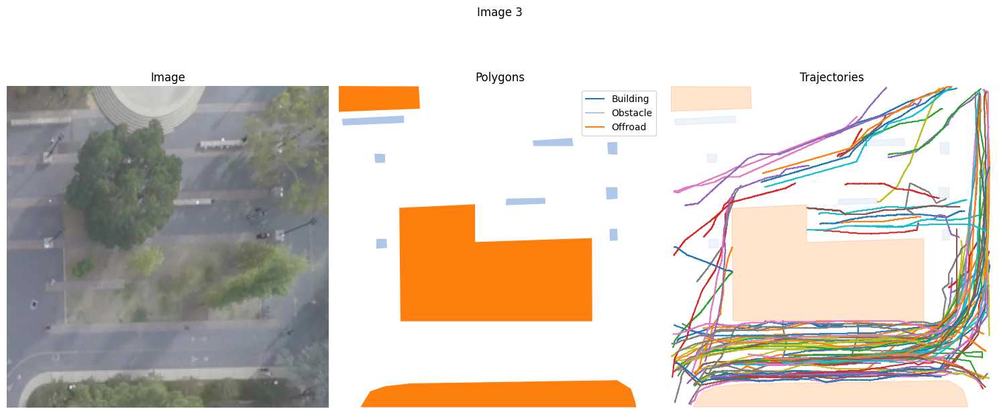

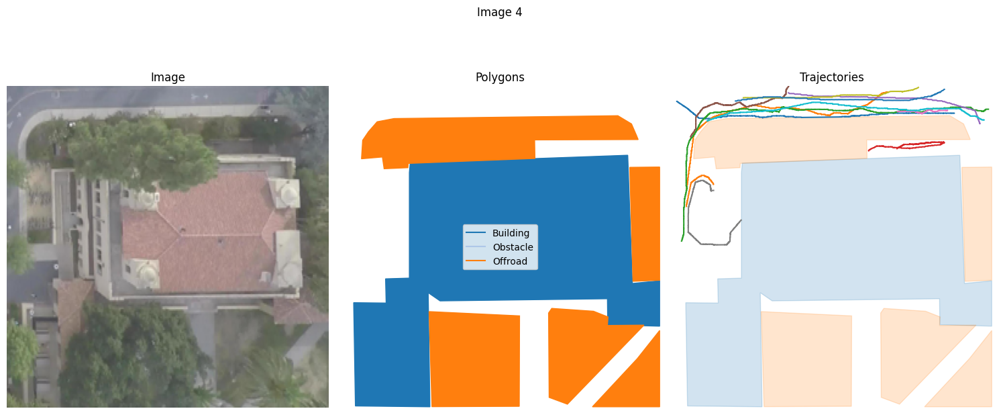

...

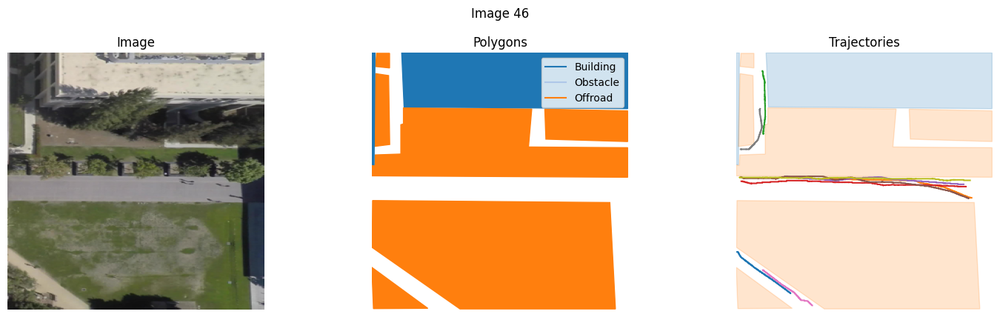

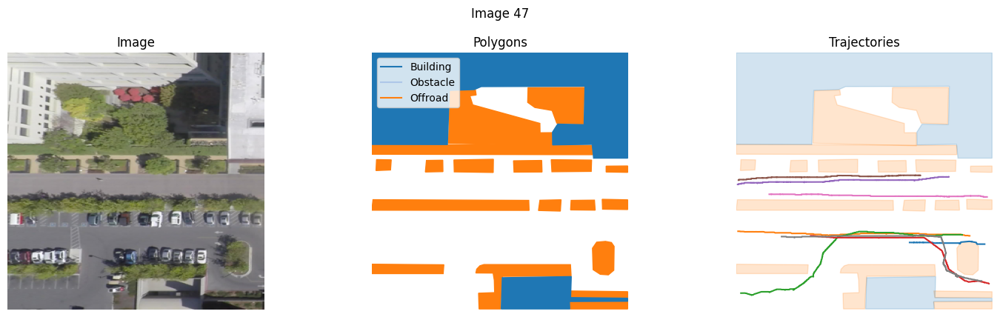

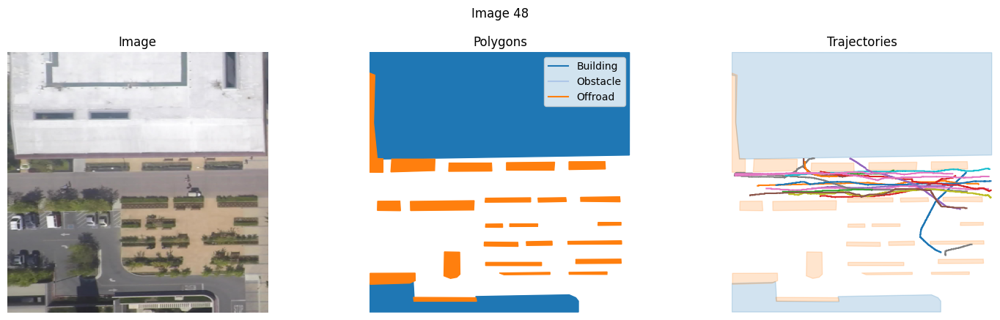

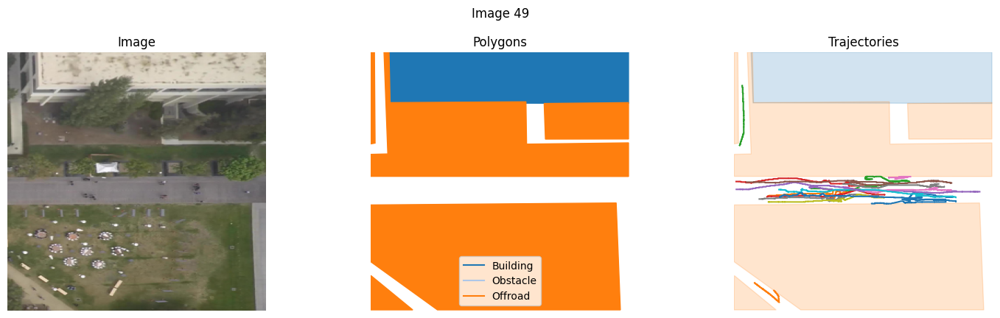

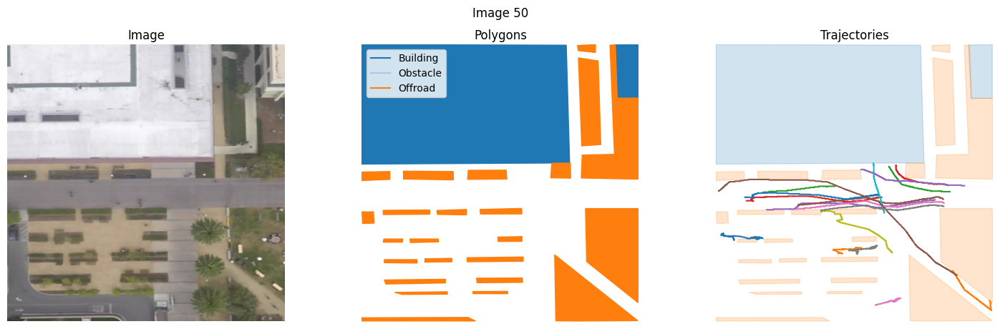

In [3]:
import matplotlib.pyplot as plt
import numpy as np

data_dir = package_root._root + "/data/sdd"

dataset = sdd.ConstrainedStanfordDroneDataset(12, sdd_data_path=data_dir)
max(list(dataset.polygons.keys()))

save_images = [0, 2, 12, 18]

for img_id in range(50+1):
    dataset = sdd.ConstrainedStanfordDroneDataset(img_id, sdd_data_path=data_dir)

    # Set the aspect ratio based on the image dimensions
    aspect_ratio = dataset.image.shape[1] / dataset.image.shape[0]

    fig_size = (15, aspect_ratio*5+1)

    fig, axs = plt.subplots(1, 3, figsize=fig_size, sharex=True, sharey=True)

    axs[0].imshow(dataset.image)
    axs[0].set_title("Image")
    axs[0].axis("off")
    axs[0].set_aspect(aspect_ratio)


    polygon_colors = {t: plt.cm.get_cmap("tab20")(i) for i, t in enumerate(dataset.constraint_classes)}

    for p_type, polygons in dataset.polygons.items():
        if not p_type in dataset.constraint_classes:
            continue
        for polygon in polygons:
            polygon = np.array(polygon)
            axs[1].fill(polygon[:, 0], polygon[:, 1], color=polygon_colors[p_type], alpha=1.0)

    axs[1].set_title("Polygons")
    axs[1].axis("off")
    # same plot dimensions as image
    axs[1].set_xlim(0, dataset.image.shape[1])
    axs[1].set_ylim(dataset.image.shape[0], 0)
    # legend
    for t, color in polygon_colors.items():
        axs[1].plot([], [], color=color, label=t)
    axs[1].legend()
    axs[1].set_aspect(aspect_ratio)


    for trajectory in dataset.get_trajectories().values():
        trajectory = np.array(trajectory)
        axs[2].plot(trajectory[:, 0], trajectory[:, 1])
    
    for p_type, polygons in dataset.polygons.items():
        if not p_type in dataset.constraint_classes:
            continue
        for polygon in polygons:
            polygon = np.array(polygon)
            axs[2].fill(polygon[:, 0], polygon[:, 1], color=polygon_colors[p_type], alpha=0.2)

    axs[2].set_title("Trajectories")
    axs[2].axis("off")
    # same plot dimensions as image
    axs[2].set_xlim(0, dataset.image.shape[1])
    axs[2].set_ylim(dataset.image.shape[0], 0)
    axs[2].set_aspect(aspect_ratio)
    
    fig.suptitle(f"Image {img_id}")
    plt.tight_layout()
    if img_id in save_images:
        plt.savefig(f"{package_root._root}/imgs/img{img_id}.png")
    plt.show()
# max(list(dataset.polygons.keys()))